In [1]:
import torch
import torchvision
from torch import nn
from torch.nn import init
from torchvision import models
from torch.utils import data
from torch.autograd import Variable

import glob
import numpy as np
from PIL import Image
import pandas as pd
import random
import copy

import matplotlib
import matplotlib.pyplot as plt

from tensorboardX import SummaryWriter

%matplotlib inline

In [2]:
is_ipython = "inline" in matplotlib.get_backend()
if is_ipython:
    from IPython import display

plt.ion()

In [3]:
def draw(x, y):
    plt.figure()
    plt.plot(x, y)
    
    if is_ipython:
        display.clear_output(wait=True)
        display.display(plt.gcf())

In [4]:
class BlinessSet(data.Dataset):
    def __init__(self, root_path, tranform=None, target_tranform=None, evaluation=False, csv_path=None):
        super(BlinessSet, self).__init__()
        
        self.root_path = root_path if root_path[-1] == '/' else root_path + '/' 
        self.csv_path = csv_path
        
        self.tranform = tranform
        self.target_tranform = target_tranform
        self.evaluation = evaluation
        
        if not self.evaluation:
            self.csv_path = csv_path
            self.csv_process()
        else:
            if self.csv_path is None:
                self.file_list = glob.glob(self.root_path + "*.png")
            else:
                self.data_collection = pd.read_csv(self.csv_path)
        
    def csv_process(self):
        self.data_collection = pd.read_csv(self.csv_path)
        
        self.classes = {}
        
        for tmp_class in self.data_collection["diagnosis"].unique():
            tmp_ = list(self.data_collection.loc[self.data_collection["diagnosis"] == tmp_class].index)
            random.shuffle(tmp_)
            self.classes[tmp_class] = tmp_
            
        self.class_number = len(self.classes.keys())
        
    def __getitem__(self, index):
        if self.csv_path is not None:
            if not self.evaluation:
                tmp_key = (index - index % 3) % self.class_number

                if index % 3 == 0:
                    tmp_index = self.classes[tmp_key][index // self.class_number % 1085]
                elif index % 3 == 1:
                    tmp_index = random.choice(self.classes[tmp_key])
                elif index % 3 == 2:
                    tmp_ = list(self.classes.keys())
                    tmp_.remove(tmp_key)
                    tmp_index = random.choice(self.classes[random.choice(tmp_)])
            else:
                tmp_index = index
            
            tmp_data = self.data_collection.loc[tmp_index]

            image_name = tmp_data["id_code"]
            image_label = tmp_data["diagnosis"]
            
            image_path = self.root_path + image_name + ".png"
        else:
            image_path = self.file_list[index]
        
        
        image = Image.open(image_path).convert("RGB")
        
        if self.tranform is not None:
            image = self.tranform(image)
            
        if self.evaluation:
            if self.csv_path is not None:
                return image, image_label
            else:            
                return image, image_path.split("/")[-1].split(".png")[0]
        else:
            if self.target_tranform is not None:
                image_label = self.target_tranform(image_label)
            
            return image, image_label
    
    def __len__(self):
        if not self.evaluation:
            self.csv_process()
            return self.data_collection.shape[0]
        else:
            if self.csv_path is None:
                return len(self.file_list)
            else:
                return self.data_collection.shape[0]

In [ ]:
class BilinearBliness(nn.Module):
    def __init__(self, num_class):
        super(BilinearBliness, self).__init__()
        base_model = models.densenet121(pretrained=True)
        base_model.classifier = nn.Sequential()
        
        self.stream_upper = copy.deepcopy(base_model)
        self.stream_lower = copy.deepcopy(base_model)
        
        self.classifier = nn.Sequential(
            nn.BatchNorm1d(1024),
            nn.ReLU(inplace=True),
            nn.Linear(in_features=1024, out_features=num_class)
        )
        
        for module in self.classifier:
            if isinstance(module, nn.Conv2d):
                nn.init.constant_(module.weight, 1)
            elif isinstance(module, nn.BatchNorm2d):
                nn.init.constant_(module.weight, 1)
                nn.init.constant_(module.bias, 0)
            elif isinstance(module, nn.BatchNorm1d):
                nn.init.constant_(module.weight, 1)
                nn.init.constant_(module.bias, 0)
            elif isinstance(module, nn.Linear):
                nn.init.constant_(module.weight, 1)
                nn.init.constant_(module.bias, 0)

    def forward(self, input_tensor):
        output_upper = self.stream_upper(input_tensor)
        output_lower = self.stream_lower(input_tensor)
        
        output_mixer = torch.mul(output_upper, output_lower)
        output_mixer = output_mixer.view(output_mixer.size(0), -1)
        
        output_mixer = self.classifier(output_mixer)
        
        return output_mixer

In [ ]:
if torch.cuda.is_available():
    CUDA_USAGE = True
    torch.backends.cudnn.benchmark = True
else:
    CUDA_USAGE = False

In [ ]:
transform_train_list = [
    torchvision.transforms.Resize((256, 256), interpolation=3),
#     torchvision.transforms.RandomHorizontalFlip(),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
]
data_transform = torchvision.transforms.Compose(transform_train_list)

In [ ]:
img_root_path = "/home/extension/kaggle/APTOS_2019_Blindness_Detection/train_images"
img_csv = "/home/hdd/hdD_Git/kaggle/image_data/classification/aptos_2019_blindness_detection/final.csv"

In [ ]:
train_dataset = BlinessSet(img_root_path, data_transform, csv_path=img_csv)
dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=18, shuffle=False, num_workers=4)

In [ ]:
model = BilinearBliness(5)
if CUDA_USAGE:
    model = model.cuda()
else:
    pass

In [ ]:
# model.load_state_dict(torch.load("/home/extension/kaggle/APTOS_2019_Blindness_Detection/models/bilinear_cnn/bilinear_cnn55.pth"))

In [ ]:
loss_function_class = torch.nn.CrossEntropyLoss().cuda()
optimizer = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.9, weight_decay=5e-4)
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, [30, 45], gamma=0.1)

In [ ]:
EPOCH = 60
ITERATION = 0
ITERATION_LIST = []
LOSS_LIST = []

In [ ]:
model_root_path = "/home/extension/kaggle/APTOS_2019_Blindness_Detection/models/bilinear_cnn/"

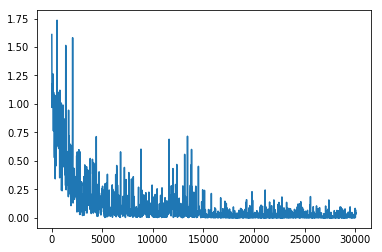

the iteration # is 30100, the loss is 0.042519465


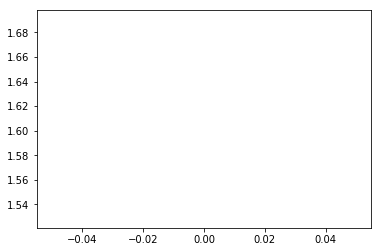

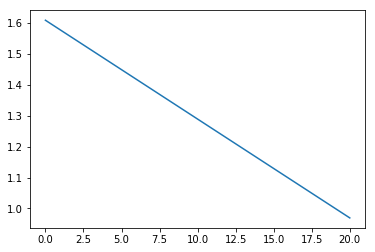

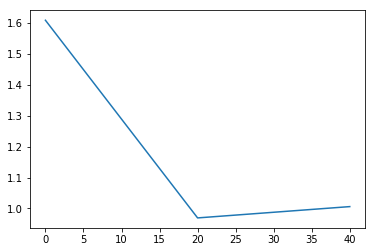

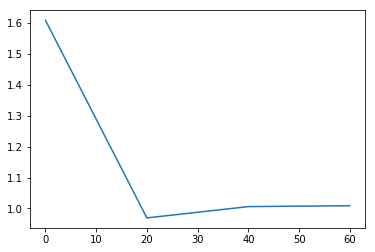

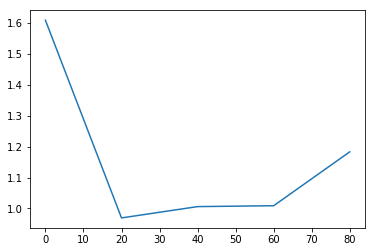

...

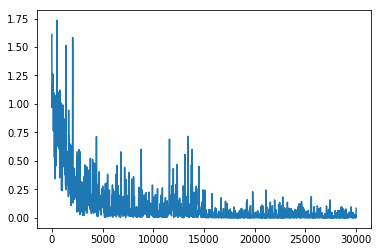

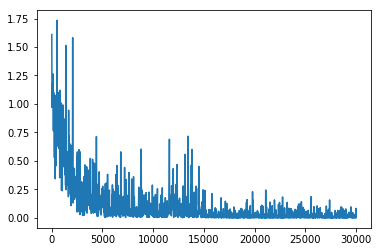

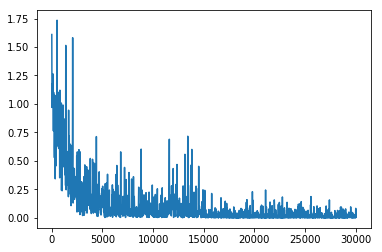

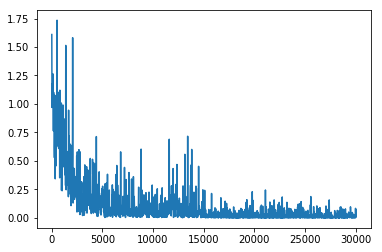

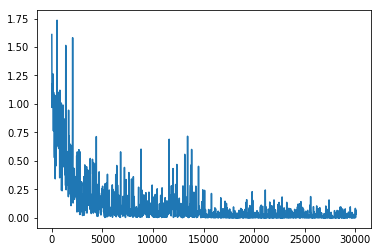

In [ ]:
try:
    for tmp_epoch in range(EPOCH):
        for data in dataloader:
            img_data, label = data
            
            if CUDA_USAGE:
                input_data = Variable(img_data.cuda())
                label = Variable(label.cuda())
            else:
                pass

            optimizer.zero_grad()

            outputs = model(input_data)
                        
#             anchor_feature = feature[0::3]
#             positive_feature = feature[1::3]
#             negtive_feature = feature[2::3]
                        
            loss = loss_function_class(outputs, label)

            loss.backward()
            optimizer.step()

            if ITERATION % 20 == 0:
                loss = loss.cpu().detach().numpy()
                LOSS_LIST.append(loss)
                ITERATION_LIST.append(ITERATION)

                draw(ITERATION_LIST, LOSS_LIST)
                print("the iteration # is %s, the loss is %s" %(ITERATION, loss))

            ITERATION += 1
            torch.cuda.empty_cache()

        if tmp_epoch % 5 == 0 and tmp_epoch != 0:
            torch.save(model.state_dict(), model_root_path + str(tmp_epoch) + ".pth")

        scheduler.step()
except KeyboardInterrupt:
    torch.save(model.state_dict(), model_root_path + "interrupt_" + str(ITERATION) + ".pth")

In [16]:
model = BilinearBliness(5)
if CUDA_USAGE:
    model = model.cuda()
else:
    pass
    
model.load_state_dict(torch.load("/home/extension/kaggle/APTOS_2019_Blindness_Detection/models/bilinear_cnn/55.pth"))
model.eval()

BilinearBliness(
  (stream_upper): DenseNet(
    (features): Sequential(
      (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu0): ReLU(inplace)
      (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (denseblock1): _DenseBlock(
        (denselayer1): _DenseLayer(
          (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu1): ReLU(inplace)
          (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu2): ReLU(inplace)
          (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (denselayer2): _DenseLayer(
          (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, 

In [17]:
test_dataset = "/home/extension/kaggle/APTOS_2019_Blindness_Detection/test_images"

In [18]:
transform_test_list = [
    torchvision.transforms.Resize((256, 256), interpolation=3),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
]
data_transform = torchvision.transforms.Compose(transform_test_list)

In [19]:
test_dataset = BlinessSet(test_dataset, data_transform, evaluation=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=8)

In [20]:
ID_CODE = []
DIAGNOSIS = []

In [21]:
for data in test_dataloader:
    with torch.no_grad():
        input_data, data_name = data
        if CUDA_USAGE:
            input_data = Variable(input_data.cuda())
            
        outputs = model(input_data)
        indices = torch.max(outputs, 1).indices
        
        ID_CODE.extend(data_name)
        DIAGNOSIS.extend(list(indices.cpu().detach().numpy()))
        
        torch.cuda.empty_cache()

In [22]:
submission = pd.DataFrame({
    "id_code": np.array(ID_CODE),
    "diagnosis": np.array(DIAGNOSIS)
})

submission.to_csv("submission.csv", index=False)

In [23]:
test = pd.read_csv("submission.csv")

In [25]:
test.head(5)

,diagnosis,id_code
0,2,e2fdc91493f4
1,4,ee98121d0c5a
2,2,c11b3794d4e9
3,2,5b18feb15d84
4,2,1d7c4c12769e


In [26]:
test.shape

(1928, 2)